## 4. 根据阳性人员的数量及辐射范围，分析确定需要重点管控的场所。
- 第一阶段：找出每天场所中病毒携带人员（指在进入场所后两天核酸检验为阳性的人员）数量
- 第二阶段：以各个场所的日均病毒携带人员数量以及人员流动数量，人员流动数量为特征值进行DBSCAN（基于密度的聚类模型，可以筛查出噪音点，没有指定簇类数量）聚类，分类为高中低风险区，但噪音点过多，效果不好
- 第三阶段：用损失函数方法筛选出风险区，损失函数越小，风险越大。计划后续补充另一种论文中的方法，正在复现。如果效果比较好，可能替换原有损失函数方法
- 第四阶段：考虑时间序列分析，由于不同场所之间的传播影响有时间滞后性，于是预估LSTM效果不好。使用格兰杰因果检验，在中高风险区查找两者因果检验p值较低的区域，就是两个区域疫情爆发有一定的因果关系。

In [1]:
import os
import pandas as pd
import matplotlib.pyplot as plt

### 第一阶段：数据导入，数据预处理部分

In [2]:
# 加载数据集
pre = 'F:/University/学期资料/大二下资料/泰迪杯/dataset/5scan/'
venue = pd.read_csv('F:/University/学期资料/大二下资料/泰迪杯/dataset/3venue.csv')
acid = pd.read_csv('F:/University/学期资料/大二下资料/泰迪杯/dataset/6acid.csv')

In [3]:
### 定义函数： 给定key-->list，建立一个所有键值为 0 的字典
def todict(x):
    my_set = x
    my_dict = {key: 0 for key in my_set}
    return my_dict

In [4]:
# 筛选出阳性者的核酸检测记录
acid_pos = acid.drop(acid[acid['jg'] == '阴性'].index)
acid_pos = acid_pos.drop(acid[acid['jg'] == '未知'].index)
acid_pos

,sno,user_id,cysj,jcsj,jg,grid_point_id
156847,154,41265,2022-10-03 13:33:21,2022-10-03 16:29:21,阳性,1062
164637,145,82882,2022-10-03 14:11:18,2022-10-03 17:23:18,阳性,2182
173278,123,96305,2022-10-03 14:52:33,2022-10-03 18:31:33,阳性,354
181011,92,76324,2022-10-03 15:29:40,2022-10-03 18:17:40,阳性,944
199993,172,31078,2022-10-04 08:31:32,2022-10-04 12:14:32,阳性,1297
...,...,...,...,...,...,...
3967846,112,52089,2022-12-01 15:43:04,2022-12-01 19:11:04,阳性,825
3967847,192,84398,2022-12-01 16:09:09,2022-12-01 19:51:09,阳性,2419
3967848,145,64551,2022-12-01 16:39:51,2022-12-01 20:20:51,阳性,1828
3967849,195,86641,2022-12-01 16:49:07,2022-12-01 19:40:07,阳性,589


#### 建立变量
acid_pos : 所有核酸检测结果为阳性的人员数据，包含人员编号，采样时间和采样地点

all_venues : 所有的场地信息

all_positive_id : 所有阳性人员的编号

all_grids : 所有的场地编号，（仅用）便于建立下面两个字典变量

flow_of_each : 字典类型，key为地点编号，value为某一地点共61天的人流量

all_po_grids_dict : 字典，key为地点编号，value为某一地点共61天的阳性人员流动量

venue_list : 将所有地点编号转换为list类型，用于做上两个字典的索引而设

mod_ob_flow : 模型需使用的目标feature-1， 因为场所编号从1开始，便于索引用None初始化第0个元素，对应使用变量flow_of_each的数据，使用举例：获取某一个场所id的61天平均人流-->mod_ob_flow[场所ID]

mod_ob_pos : 模型需使用的目标feature-2， 同上

In [5]:
# 筛选出阳性者的核酸检测记录
acid_pos = acid.drop(acid[acid['jg'] == '阴性'].index)
acid_pos = acid_pos.drop(acid[acid['jg'] == '未知'].index)
acid_pos = acid_pos[['user_id', 'cysj', 'grid_point_id']]

all_venues = venue
all_positive_id = acid.user_id.unique()
files = os.listdir(pre)

all_grids = set(all_venues['grid_point_id'].tolist())
all_po_grids_dict = todict(all_grids)
flow_of_each = todict(all_grids)

keys = flow_of_each.keys()
venue_list = list(keys)

mod_ob_flow = [None]
mod_ob_pos = [None]
## 访问某一个场所的61天数据： mod_ob[venue_list] = list_array {....}

开始查找

In [6]:
idx = 0
## 遍历每一天的数据集
for file_name in files:
    df_scan = pd.read_csv(pre+file_name)
    e = df_scan[['user_id','grid_point_id','create_time']]
    sample_slice_id = [] ## 每一天人在两天后的核酸检测结果为阳性的人员id
    ## 遍历第一次获取目标时间范围点
    for _, row in e.iterrows():
        enter_time = row[2][:10] ## 扫码时间 13
        obj_time = pd.to_datetime(enter_time, format='%Y-%m-%d')  ## 扫码时间后两天-- 核酸检测当天 15
        obj_time_m = obj_time + pd.Timedelta(days=1) ## 核酸检测时间结束16
        mask = (pd.to_datetime(acid_pos['cysj']) >= obj_time) & (pd.to_datetime(acid_pos['cysj']) <= obj_time_m)
        sample_slice_id = acid_pos[mask]['user_id'].to_list() ## 获得此时 将在两天后为阳性 的人员id
        break

    ## 每一天中每一行
    for _, row in e.iterrows():
        grid_id = row[1] ## 扫码地点
        flow_of_each[grid_id] += 1 ## 人流加一

        if row[0] in sample_slice_id: ## 该人若在目标list中 (阳性)
            place_id = grid_id
            all_po_grids_dict[place_id] += 1

    print(idx)
    idx+=1

0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60


In [8]:
for id in all_grids:
    print('场所编号',id, "{ 人流量: ", flow_of_each[id], ",\t阳性人员流动量: ", all_po_grids_dict[id],"}")

场所编号 1 { 人流量:  585 ,	阳性人员流动量:  0 }
场所编号 2 { 人流量:  4853 ,	阳性人员流动量:  0 }
场所编号 3 { 人流量:  144 ,	阳性人员流动量:  0 }
场所编号 4 { 人流量:  539 ,	阳性人员流动量:  0 }
场所编号 5 { 人流量:  5852 ,	阳性人员流动量:  2 }
场所编号 6 { 人流量:  4465 ,	阳性人员流动量:  2 }
场所编号 7 { 人流量:  6499 ,	阳性人员流动量:  0 }
场所编号 8 { 人流量:  4866 ,	阳性人员流动量:  1 }
场所编号 9 { 人流量:  4488 ,	阳性人员流动量:  0 }
场所编号 10 { 人流量:  7031 ,	阳性人员流动量:  0 }
场所编号 11 { 人流量:  5208 ,	阳性人员流动量:  1 }
场所编号 12 { 人流量:  8261 ,	阳性人员流动量:  1 }
场所编号 13 { 人流量:  3645 ,	阳性人员流动量:  0 }
场所编号 14 { 人流量:  3866 ,	阳性人员流动量:  1 }
场所编号 15 { 人流量:  6332 ,	阳性人员流动量:  0 }
场所编号 16 { 人流量:  3090 ,	阳性人员流动量:  0 }
场所编号 17 { 人流量:  5088 ,	阳性人员流动量:  1 }
场所编号 18 { 人流量:  4585 ,	阳性人员流动量:  1 }
场所编号 19 { 人流量:  7397 ,	阳性人员流动量:  2 }
场所编号 20 { 人流量:  4516 ,	阳性人员流动量:  0 }
场所编号 21 { 人流量:  5867 ,	阳性人员流动量:  1 }
场所编号 22 { 人流量:  5485 ,	阳性人员流动量:  1 }
场所编号 23 { 人流量:  8965 ,	阳性人员流动量:  1 }
场所编号 24 { 人流量:  5094 ,	阳性人员流动量:  2 }
场所编号 25 { 人流量:  5093 ,	阳性人员流动量:  0 }
场所编号 26 { 人流量:  5568 ,	阳性人员流动量:  1 }
场所编号 27 { 人流量:  4628 ,	阳性人员流动量:  1 }
场所编号 28 { 人流量

### 第一阶段：建立特征值

导入模型

In [9]:
mod_ob_flow = flow_of_each
mod_ob_pos = all_po_grids_dict

In [10]:
# 特征1：特定场所出现阳性人员数量
feature_1 = pd.DataFrame([mod_ob_pos])
# 特征2：场所人数
feature_2 = pd.DataFrame([mod_ob_flow])

feature_1 = feature_1.transpose()
feature_2 = feature_2.transpose()

In [11]:
# 检查feature_2中哪些行的数值为0
zero_mask = (feature_2 == 0)

# 为这些行中的所有元素分配0
feature_1[zero_mask] = 0

# 将非零元素除以feature_2中的元素，并将结果分配回feature_1
nonzero_mask = (feature_2 != 0)
feature_1[nonzero_mask] = feature_1[nonzero_mask] * 10000 / feature_2[nonzero_mask]
# 特征1：特定场所出现阳性人员数量*10000/场所人数
feature_1


,0
1,0.000000
2,0.000000
3,0.000000
4,0.000000
5,3.417635
...,...
2943,0.000000
2944,6.504065
2945,0.000000
2946,0.000000


In [12]:
# 特征3：特定场所出现阳性人员数量
feature_3 = pd.DataFrame([mod_ob_pos])
feature_3.fillna(0)
feature_3 = feature_3.transpose()
feature_3.rename(columns = {feature_1.columns[0]:'累计阳性人次'},inplace=True)
feature_3

,累计阳性人次
1,0
2,0
3,0
4,0
5,2
...,...
2943,0
2944,2
2945,0
2946,0


In [13]:
feature_3.describe()

,累计阳性人次
count,2947.000000
mean,1.174754
std,3.161473
min,0.000000
25%,0.000000
50%,0.000000
75%,1.000000
max,41.000000


In [14]:
feature_2.describe()

,0
count,2947.000000
mean,8263.922633
std,20416.037760
min,0.000000
25%,2759.000000
50%,4478.000000
75%,5517.500000
max,201670.000000


### 第二阶段尝试用聚类方法，以DBSCAN为例子

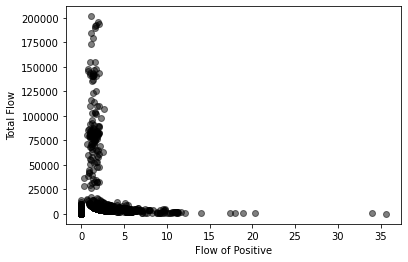

CV-1 score: 0.6884
CV-2 score: 0.6973
CV-3 score: 0.6699
CV-4 score: 0.6966
CV-5 score: 0.6704


In [15]:
from sklearn.cluster import DBSCAN

# 创建DBSCAN聚类器对象
dbscan = DBSCAN(eps=5, min_samples=10)

# 对feature_1和feature_2进行聚类
labels = dbscan.fit_predict(pd.concat([feature_1, feature_2], axis=1))

# 获取聚类的数量
n_clusters = len(pd.DataFrame(labels).value_counts())-1

# 创建颜色映射
colors = ['red', 'blue', 'green', 'yellow', 'purple', 'orange', 'pink', 'brown', 'grey', 'black',
          'cyan', 'magenta', 'gold', 'olive', 'lime', 'teal', 'navy', 'indigo', 'maroon', 'silver']


#绘制噪音点
mask = labels == -1
plt.scatter(feature_1[mask], feature_2[mask], c='black', alpha=0.5)

# 绘制聚类结果散点图

plt.xlabel('Flow of Positive')
plt.ylabel('Total Flow')
plt.savefig('img/cluster_1')
plt.show()

from sklearn.preprocessing import StandardScaler

scaler = StandardScaler()
feature_1_scaled = scaler.fit_transform(feature_1)
feature_2_scaled = scaler.fit_transform(feature_2)

import numpy as np

features = np.hstack([feature_1_scaled, feature_2_scaled])

from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
from sklearn.model_selection import train_test_split

# 交叉验证的划分比例
test_size = 0.3
random_state = 42

# 进行交叉验证
for i in range(5):
    X_train, X_test = train_test_split(features, test_size=test_size, random_state=random_state * i)
    kmeans = KMeans(n_clusters=3, random_state=0).fit(X_train)

    y_pred = kmeans.predict(X_test)
    score = silhouette_score(X_test, y_pred)
    print(f"CV-{i + 1} score: {score:.4f}")

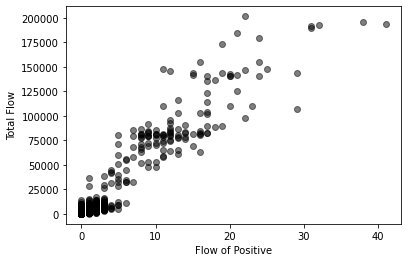

CV-1 score: 0.9137
CV-2 score: 0.9172
CV-3 score: 0.9046
CV-4 score: 0.9185
CV-5 score: 0.9140


In [16]:
# 创建DBSCAN聚类器对象
dbscan = DBSCAN(eps=5, min_samples=10)

# 对feature_3和feature_2进行聚类
labels = dbscan.fit_predict(pd.concat([feature_3, feature_2], axis=1))

# 获取聚类的数量
n_clusters = len(pd.DataFrame(labels).value_counts())-1

# 创建颜色映射
colors = ['red', 'blue', 'green', 'yellow', 'purple', 'orange', 'pink', 'brown', 'grey', 'black',
          'cyan', 'magenta', 'gold', 'olive', 'lime', 'teal', 'navy', 'indigo', 'maroon', 'silver']


#绘制噪音点
mask = labels == -1
plt.scatter(feature_3[mask], feature_2[mask], c='black', alpha=0.5)

# 绘制聚类结果散点图
# for i in range(n_clusters):
#     mask = labels == i
#     plt.scatter(feature_3[mask], feature_2[mask], c=colors[i])

plt.xlabel('Flow of Positive')
plt.ylabel('Total Flow')
plt.savefig('img/cluster_2')
plt.show()

from sklearn.preprocessing import StandardScaler

scaler = StandardScaler()
feature_3_scaled = scaler.fit_transform(feature_3)
feature_2_scaled = scaler.fit_transform(feature_2)

import numpy as np

features = np.hstack([feature_3_scaled, feature_2_scaled])

from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
from sklearn.model_selection import train_test_split

# 交叉验证的划分比例
test_size = 0.3
random_state = 42

# 进行交叉验证
for i in range(5):
    X_train, X_test = train_test_split(features, test_size=test_size, random_state=random_state * i)
    kmeans = KMeans(n_clusters=3, random_state=0).fit(X_train)

    y_pred = kmeans.predict(X_test)
    score = silhouette_score(X_test, y_pred)
    print(f"CV-{i + 1} score: {score:.4f}")

上图为噪音点，DBSCAN聚类器对象效果不好，于是更换方法

### 第三阶段：损失函数

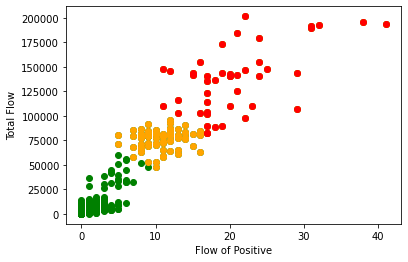

In [36]:
# 特征2：场所人数
# 特征3：阳性人次

# 将feature_2和feature_3合并成一个数据集
data = pd.concat([feature_3, feature_2], axis=1)

# 计算每个点的损失函数值
loss = 1 / (data.iloc[:, 0] ** 2 +  ((0.0002 * data.iloc[:, 1]) ** 2))

# 找到损失函数值最大的5%的点
threshold_1 = np.percentile(loss, 1.5)
threshold_2 = np.percentile(loss, 4)
outliers_high = np.where(loss < threshold_1)
outliers_medium = np.where(loss < threshold_2)

# 绘制结果
import matplotlib.pyplot as plt
plt.scatter(data.iloc[:, 0], data.iloc[:, 1], c='green')
for i in outliers_medium[0]:
    plt.scatter(data.iloc[i, 0], data.iloc[i, 1], c='orange')
for i in outliers_high[0]:
    plt.scatter(data.iloc[i, 0], data.iloc[i, 1], c='red')
plt.xlabel('Flow of Positive')
plt.ylabel('Total Flow')
plt.savefig('img/Division_RiskyAreas')
plt.show()



得到中风险区和高风险区

In [37]:
targetVenues = outliers_medium[0]
outliers_high = outliers_high[0]
outliers_medium = outliers_medium[0]
set1 = set(outliers_high)
set2 = set(outliers_medium)
set3 = set2-set1
outliers_medium_temp = tuple(set3)
outliers_medium = outliers_medium_temp
print(len(outliers_medium_temp)==len(outliers_medium))
print('高风险区',len(outliers_high))
print('中风险区',len(outliers_medium_temp))

True
高风险区 45
中风险区 73


In [38]:
feature_3
targetVenues = [x + 1 for x in targetVenues]
venue
cordinates = venue.loc[venue['grid_point_id'].isin(targetVenues)]

cordinates


,grid_point_id,name,point_type,x_coordinate,y_coordinate,create_time
48,49,居民小区1,住宅,14098.83,11960.41,2021/8/9 7:48
101,102,地铁站2,交通,15179.91,12137.15,2022/7/5 16:27
107,108,居民小区2,住宅,16331.03,11048.13,2021/1/23 21:56
166,167,居民小区3,住宅,13308.25,15707.57,2020/7/10 2:35
218,219,公交车4,交通,11808.33,14733.07,2021/12/24 3:26
...,...,...,...,...,...,...
2815,2816,地铁站48,交通,9044.77,18237.79,2020/6/3 11:06
2821,2822,居民小区48,住宅,11767.34,18431.86,2021/11/30 8:52
2874,2875,地铁站49,交通,12332.49,17478.13,2021/10/23 20:07
2880,2881,居民小区49,住宅,9290.16,17076.51,2022/5/1 2:34


In [39]:
feature_3.index.name = 'grid_point_id'
feature_3
cordinates = cordinates[['grid_point_id','x_coordinate','y_coordinate']]

# 先将feature_3的index重命名为grid_point_id
# 合并
cordinates['累计阳性人次'] = cordinates.apply(lambda row: feature_3.loc[row['grid_point_id'], '累计阳性人次'], axis=1)
cordinates

F:\Anaconda3 2022.10\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys


,grid_point_id,x_coordinate,y_coordinate,累计阳性人次
48,49,14098.83,11960.41,9
101,102,15179.91,12137.15,17
107,108,16331.03,11048.13,15
166,167,13308.25,15707.57,17
218,219,11808.33,14733.07,11
...,...,...,...,...
2815,2816,9044.77,18237.79,8
2821,2822,11767.34,18431.86,24
2874,2875,12332.49,17478.13,16
2880,2881,9290.16,17076.51,20


In [42]:
cordinates.iloc[0,0]

49

In [51]:
import scipy

# 读取数据
data = cordinates

# 计算欧几里得距离矩阵
def euclidean_distance_matrix(data):
    n = len(data)
    distances = np.zeros((n, n))
    for i in range(n):
        for j in range(n):
            distances[i, j] = np.sqrt((data.iloc[i, 1] - data.iloc[j, 1])**2
                                      + (data.iloc[i, 2] - data.iloc[j, 2])**2)
    return distances

# 计算空间权重矩阵
def spatial_weight_matrix(data):
    distances = euclidean_distance_matrix(data)
    weights = np.zeros((len(data), len(data)))
    for i in range(len(data)):
        for j in range(len(data)):
            if i == j:
                weights[i, j] = 0
            else:
                weights[i, j] = 1 / distances[i, j] if distances[i, j] != 0 else 0
    return weights

# 计算Moran's I指标
def morans_I(data):
    x = data.iloc[:, 3]
    n = len(x)
    w = spatial_weight_matrix(data)
    wx = w @ x
    sum_x = np.sum(x)
    sum_w = np.sum(w)
    sum_wx = np.sum(wx)
    mean_x = sum_x / n
    s0 = np.sum((x - mean_x)**2)
    s1 = np.sum(wx**2) / sum_w
    s2 = (sum_wx / sum_w)**2
    I = (n / s0) * ((s1 - s2) / (s0 / (n-1)))
    return I, w

# 输出结果
I, w = morans_I(data)
print(I)
print(w)

# # 这个cell不用管！！！！！！！！！！！！！！！正在debug


-0.09224857463058952
[[0.00000000e+00 9.12881962e-04 4.14692518e-04 ... 1.72605821e-04
  1.42425021e-04 1.18840192e-04]
 [9.12881962e-04 0.00000000e+00 6.31063450e-04 ... 1.65218476e-04
  1.30093655e-04 1.33565146e-04]
 [4.14692518e-04 6.31063450e-04 0.00000000e+00 ... 1.32067764e-04
  1.07885967e-04 1.32083210e-04]
 ...
 [1.72605821e-04 1.65218476e-04 1.32067764e-04 ... 0.00000000e+00
  3.25868281e-04 1.20871234e-04]
 [1.42425021e-04 1.30093655e-04 1.07885967e-04 ... 3.25868281e-04
  0.00000000e+00 8.83719203e-05]
 [1.18840192e-04 1.33565146e-04 1.32083210e-04 ... 1.20871234e-04
  8.83719203e-05 0.00000000e+00]]


In [52]:
data.iloc[:, 2]

48      11960.41
101     12137.15
107     11048.13
166     15707.57
218     14733.07
          ...   
2815    18237.79
2821    18431.86
2874    17478.13
2880    17076.51
2939    17298.19
Name: y_coordinate, Length: 118, dtype: float64

In [87]:
def count_neighbors(data, distance_threshold):
    n = len(data)
    neighbor_counts = np.zeros(n)
    neighbor_positions = [[] for _ in range(n)]
    for i in range(n):
        for j in range(n):
            if i == j:
                continue
            distance = np.sqrt((data.iloc[i, 1] - data.iloc[j, 1])**2
                                  + (data.iloc[i, 2] - data.iloc[j, 2])**2)
            if distance <= distance_threshold:
                neighbor_counts[i] += 1
                neighbor_positions[i].append(j)
    return neighbor_counts, neighbor_positions
def spatial_weight_matrix(data):
    distances = euclidean_distance_matrix(data)
    weights = np.zeros((len(data), len(data)))
    for i in range(len(data)):
        for j in range(len(data)):
            if i == j:
                weights[i, j] = 0
            else:
                if distances[i, j] == 0:
                    weights[i, j] = 0
                else:
                    weights[i, j] = 1 / distances[i, j]
    return weights

def local_morans_I(data, neighbor_counts, neighbor_positions):
    x = data.iloc[:, 3]
    n = len(x)
    w = spatial_weight_matrix(data)
    wx = w @ x
    sum_x = np.sum(x)
    sum_w = np.sum(w)
    sum_wx = np.sum(wx)
    mean_x = sum_x / n
    epsilon = 1e-5 # 增加epsilon的值
    s0 = np.sum((x - mean_x)**2) + epsilon
    s1 = np.sum(wx**2) / sum_w
    s2 = (sum_wx / sum_w)**2
    I = (n / s0) * ((s1 - s2) / (s0 / (n-1)))

    local_I = np.zeros(n)
    for i in range(n):
        if neighbor_counts[i] == 0:
            continue
        xi_bar = np.mean(x.iloc[neighbor_positions[i]]) # 修改这一行，使用iloc
        s0i = np.sum((x.iloc[neighbor_positions[i]] - xi_bar)**2) # 修改这一行，使用iloc
        s1i = np.sum(w[i, neighbor_positions[i]] * wx[neighbor_positions[i]])
        s2i = (np.sum(w[i, neighbor_positions[i]]) * xi_bar)**2
        local_I[i] = (neighbor_counts[i] / s0i) * ((s1i - s2i) / (s0i / (neighbor_counts[i]-1)))

    return local_I


radius = 800
neighbor_counts, neighbor_positions = count_neighbors(data, radius)
local_I = local_morans_I(data, neighbor_counts, neighbor_positions)
print(local_I)


[-1.57054787e-03 -4.09195063e-06 -2.12529002e-06 -5.94008546e-06
 -1.18221991e-05  1.38845631e-07 -4.83996590e-05 -3.42370067e-06
 -1.78119984e-05             nan -1.89829365e-04 -3.90056059e-05
 -1.16752739e-04  4.40709212e-04  2.56645366e-05 -9.00190709e-05
 -2.56307808e-04             nan -6.48575682e-05 -1.53710890e-04
 -1.18255685e-03 -1.34794150e-04 -3.11680943e-05 -7.41548938e-05
 -1.90475559e-06 -2.46652322e-05 -1.73135032e-05  5.46578139e-05
             nan  0.00000000e+00 -3.87094786e-06  7.49302561e-03
 -2.35013779e-05 -4.99502901e-04 -2.91658156e-05 -5.41286949e-03
 -1.39292792e-05             nan             nan -7.33426935e-06
  0.00000000e+00  0.00000000e+00  0.00000000e+00 -6.05489073e-04
 -2.03489258e-01 -2.12506627e-04             nan -8.04227915e-05
             nan -6.80429271e-05             nan  0.00000000e+00
  0.00000000e+00 -1.02526249e-02             nan  1.14919205e-05
 -9.57418170e-06 -6.27304942e-05 -1.40115921e-04 -1.23902859e-04
             nan         

F:\Anaconda3 2022.10\lib\site-packages\ipykernel_launcher.py:52: RuntimeWarning: divide by zero encountered in double_scalars
F:\Anaconda3 2022.10\lib\site-packages\ipykernel_launcher.py:52: RuntimeWarning: invalid value encountered in double_scalars


In [88]:
local_I = np.around(local_I, decimals=6)
local_I

array([-1.57100e-03, -4.00000e-06, -2.00000e-06, -6.00000e-06,
       -1.20000e-05,  0.00000e+00, -4.80000e-05, -3.00000e-06,
       -1.80000e-05,          nan, -1.90000e-04, -3.90000e-05,
       -1.17000e-04,  4.41000e-04,  2.60000e-05, -9.00000e-05,
       -2.56000e-04,          nan, -6.50000e-05, -1.54000e-04,
       -1.18300e-03, -1.35000e-04, -3.10000e-05, -7.40000e-05,
       -2.00000e-06, -2.50000e-05, -1.70000e-05,  5.50000e-05,
                nan,  0.00000e+00, -4.00000e-06,  7.49300e-03,
       -2.40000e-05, -5.00000e-04, -2.90000e-05, -5.41300e-03,
       -1.40000e-05,          nan,          nan, -7.00000e-06,
        0.00000e+00,  0.00000e+00,  0.00000e+00, -6.05000e-04,
       -2.03489e-01, -2.13000e-04,          nan, -8.00000e-05,
                nan, -6.80000e-05,          nan,  0.00000e+00,
        0.00000e+00, -1.02530e-02,          nan,  1.10000e-05,
       -1.00000e-05, -6.30000e-05, -1.40000e-04, -1.24000e-04,
                nan,          nan, -3.80000e-05, -7.000

In [89]:
type(local_I)

numpy.ndarray

In [90]:
from scipy.special import expit
activate = expit(local_I)
activate = pd.DataFrame(activate)
activate  = activate.rename(columns={activate.columns[0]: '风险系数'})
activate.fillna(0.5, inplace=True)
activate

,风险系数
0,0.499607
1,0.499999
2,0.499999
3,0.499999
4,0.499997
...,...
113,0.500000
114,0.500000
115,0.500000
116,0.500000


In [92]:
cordinates.reset_index(inplace = True)
cordinates

,index,grid_point_id,x_coordinate,y_coordinate,累计阳性人次
0,48,49,14098.83,11960.41,9
1,101,102,15179.91,12137.15,17
2,107,108,16331.03,11048.13,15
3,166,167,13308.25,15707.57,17
4,218,219,11808.33,14733.07,11
...,...,...,...,...,...
113,2815,2816,9044.77,18237.79,8
114,2821,2822,11767.34,18431.86,24
115,2874,2875,12332.49,17478.13,16
116,2880,2881,9290.16,17076.51,20


In [96]:
riskCriterion = pd.concat([cordinates, activate], axis=1)
riskCriterion = riskCriterion.drop('index',axis=1)
riskCriterion

,grid_point_id,x_coordinate,y_coordinate,累计阳性人次,风险系数
0,49,14098.83,11960.41,9,0.499607
1,102,15179.91,12137.15,17,0.499999
2,108,16331.03,11048.13,15,0.499999
3,167,13308.25,15707.57,17,0.499999
4,219,11808.33,14733.07,11,0.499997
...,...,...,...,...,...
113,2816,9044.77,18237.79,8,0.500000
114,2822,11767.34,18431.86,24,0.500000
115,2875,12332.49,17478.13,16,0.500000
116,2881,9290.16,17076.51,20,0.500000


### 第四阶段：
#### 基于时间序列的对不同场所的疫情爆发的因果检验模型
#### 尝试对损失函数筛选出风险区与高风险区进行格兰杰因果检验
参考资料：http://t.csdn.cn/btgwj

#### 数据预处理

In [19]:
# 加载数据集
pre = 'F:/University/学期资料/大二下资料/泰迪杯/dataset/5scan/'
venue = pd.read_csv('F:/University/学期资料/大二下资料/泰迪杯/dataset/3venue.csv')
acid = pd.read_csv('F:/University/学期资料/大二下资料/泰迪杯/dataset/6acid.csv')
pos_travel_info = pd.read_csv('F:/University/学期资料/大二下资料/泰迪杯/dataset/pos_travel_info.csv')
all_positive_places = pos_travel_info.grid_id

In [20]:
### 定义函数： 给定key-->list，建立一个所有键值为 0 的字典
def todict(x):
    my_set = x
    my_dict = {key: 0 for key in my_set}
    return my_dict

In [21]:
# 筛选出阳性者的核酸检测记录
acid_pos = acid.drop(acid[acid['jg'] == '阴性'].index)
acid_pos = acid_pos.drop(acid[acid['jg'] == '未知'].index)
acid_pos

,sno,user_id,cysj,jcsj,jg,grid_point_id
156847,154,41265,2022-10-03 13:33:21,2022-10-03 16:29:21,阳性,1062
164637,145,82882,2022-10-03 14:11:18,2022-10-03 17:23:18,阳性,2182
173278,123,96305,2022-10-03 14:52:33,2022-10-03 18:31:33,阳性,354
181011,92,76324,2022-10-03 15:29:40,2022-10-03 18:17:40,阳性,944
199993,172,31078,2022-10-04 08:31:32,2022-10-04 12:14:32,阳性,1297
...,...,...,...,...,...,...
3967846,112,52089,2022-12-01 15:43:04,2022-12-01 19:11:04,阳性,825
3967847,192,84398,2022-12-01 16:09:09,2022-12-01 19:51:09,阳性,2419
3967848,145,64551,2022-12-01 16:39:51,2022-12-01 20:20:51,阳性,1828
3967849,195,86641,2022-12-01 16:49:07,2022-12-01 19:40:07,阳性,589


In [22]:
# 筛选出阳性者的核酸检测记录
acid_pos = acid_pos[['user_id', 'cysj', 'grid_point_id']]

all_venues = venue
all_positive_id = acid.user_id.unique()
files = os.listdir(pre)

all_grids = set(all_venues['grid_point_id'].tolist())
all_po_grids_dict = todict(all_grids)
flow_of_each = todict(all_grids)

keys = flow_of_each.keys()
venue_list = list(keys)

mod_ob_flow = []
mod_ob_pos = []
## 访问某一个场所第i天（i从0开始）数据： mod_ob[i][venue_list] = list_array {....}

In [23]:
import os
prefix = 'F:/University/学期资料/大二下资料/泰迪杯/dataset/5scan/'
files = os.listdir(prefix)

#### 查找场所人日人流量以及阳性人员每日流量

In [24]:
# pos_cur : 阳性人员每日人流量, 长度为61，每个元素代表所有场所在这一天的人流量，对应pos_inner
# all_cur : 每日人流量，长度61， 每个元素代表所有场所在这一天中的人流量 对应all_inner

pos_cur = 61*[0]
all_cur = 61*[0]
pos_inner = [0]*2948
all_inner = [0]*2948

idx = 0
#### 第 idx 天， 从0开始
for file_name in files:
    print(idx)
    ## 每一天数据：
    df_scan = pd.read_csv(prefix+file_name)
    e = df_scan[['user_id','grid_point_id']]

    today_grids = e.grid_point_id
    distinct_grid = today_grids.unique().tolist()
    today_grid_list = today_grids.tolist()
    for gid in distinct_grid:
        all_inner[gid] = today_grid_list.count(gid)
    all_cur[idx] = all_inner
    all_inner = [0]*2948


    date = pd.to_datetime(file_name[:8],format="%Y%m%d")
    end = date + pd.Timedelta(days=1)
    temp = acid_pos[(pd.to_datetime(acid_pos['cysj'],format="%Y-%m-%d") <=end) & (pd.to_datetime(acid_pos['cysj'] ,format="%Y-%m-%d")>=date)]
    pos_id_today = temp.user_id.unique()

    ## 没有阳性
    if pos_id_today.size==0:
        pos_cur[idx] = pos_inner
        pos_inner = [0]*2948

    ## 存在阳性流动
    else:
        pos_e = e[e.user_id.isin(pos_id_today)]
        pos_grid = pos_e.grid_point_id
        distinct_pos_grid = pos_grid.unique().tolist()
        pos_grid = pos_grid.tolist()
        for gid in distinct_pos_grid:
            pos_inner[gid] = pos_grid.count(gid)
        pos_cur[idx] = pos_inner
        pos_inner = [0]*2948

    idx += 1

0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60


#### 进行格兰杰因果性检验

In [25]:
# pos_cur : 阳性人员每日人流量, 长度为61，每个元素代表所有场所在这一天的人流量，对应pos_inner
gFeature_1 = pd.DataFrame(pos_cur)
# all_cur : 每日人流量，长度61， 每个元素代表所有场所在这一天中的人流量 对应all_inner
gFeature_2 = pd.DataFrame(all_cur)

In [26]:
from statsmodels.tsa.stattools import grangercausalitytests
# 定义函数
def GrangerCausality(data1,data2,alpha):
    # 将数据转换为 2D 数组
    data_all = np.column_stack((data1, data2))
    data_all1 = [[row[0], row[1]] for row in data_all]
    # 进行格兰杰因果检验，设置最大滞后期为 3
    result = grangercausalitytests(data_all1, maxlag=3)
    # 显著性水平 alpha
    # 输出检验结果
    print("格兰杰因果检验结果：")
    pValues = list()
    for lag in result.keys():
        print("滞后期 = %d" % lag)
        print("F统计量 = %.2f, p值 = %.4f, 根据显著性水平%.2f，" % (result[lag][0]['params_ftest'][0], result[lag][0]['params_ftest'][1],alpha), end='')
        pValues.append(round(result[lag][0]['params_ftest'][1],5))
        if result[lag][0]['params_ftest'][1] < alpha :
            print("存在因果关系。")
        else:
            print("不存在因果关系。")
    return pValues

In [27]:
targetVenues

array([  48,  101,  107,  166,  218,  219,  225,  277,  278,  284,  336,
        337,  343,  395,  396,  402,  454,  455,  461,  514,  520,  579,
        631,  632,  638,  690,  697,  749,  750,  756,  808,  809,  815,
        867,  874,  926,  927,  933,  985,  986,  992, 1044, 1051, 1103,
       1104, 1110, 1162, 1163, 1169, 1222, 1228, 1280, 1287, 1339, 1340,
       1346, 1398, 1399, 1405, 1457, 1458, 1464, 1516, 1517, 1523, 1575,
       1576, 1582, 1634, 1635, 1641, 1693, 1694, 1700, 1752, 1753, 1759,
       1811, 1812, 1818, 1871, 1877, 1929, 1930, 1936, 1989, 1995, 2054,
       2106, 2113, 2165, 2172, 2224, 2231, 2284, 2290, 2343, 2349, 2401,
       2408, 2467, 2519, 2526, 2585, 2637, 2638, 2644, 2696, 2697, 2703,
       2756, 2762, 2814, 2815, 2821, 2874, 2880, 2939], dtype=int64)

#### 使用累计阳性人数作为拟合数据

In [28]:
# 每个场所累计阳性人次
gFeature_3 = gFeature_1.cumsum()
# 显著性水平
alpha = 0.05
pValues_sum = list()
sum_left = list()
sum_right = list()

for i in targetVenues:
    print((i+1),'th Venues Test:')
    # 遍历中高风险
    pValuesTemp = list()
    data1 = gFeature_3[i+1]
    j = 1
    for j in targetVenues:
        if j!=i:
            data2 = gFeature_3[j+1]
            pValuesTemp.append(GrangerCausality(data1,data2,alpha))
            if pValuesTemp[0][0]<=alpha or pValuesTemp[0][1]<=alpha or pValuesTemp[0][2]<=alpha:
                sum_left.append(i)
                sum_right.append(j)
            j += 1
        else:
            temp = list()
            temp.append(0)
            temp.append(0)
            temp.append(0)
            pValuesTemp.append(temp)
            j += 1
    pValues_sum.append(pValuesTemp)
    i += 1


49 th Venues Test:

Granger Causality
number of lags (no zero) 1
ssr based F test:         F=13.6095 , p=0.0005  , df_denom=57, df_num=1
ssr based chi2 test:   chi2=14.3257 , p=0.0002  , df=1
likelihood ratio test: chi2=12.8468 , p=0.0003  , df=1
parameter F test:         F=13.6095 , p=0.0005  , df_denom=57, df_num=1

Granger Causality
number of lags (no zero) 2
ssr based F test:         F=6.2736  , p=0.0035  , df_denom=54, df_num=2
ssr based chi2 test:   chi2=13.7090 , p=0.0011  , df=2
likelihood ratio test: chi2=12.3267 , p=0.0021  , df=2
parameter F test:         F=6.2736  , p=0.0035  , df_denom=54, df_num=2

Granger Causality
number of lags (no zero) 3
ssr based F test:         F=4.2423  , p=0.0094  , df_denom=51, df_num=3
ssr based chi2 test:   chi2=14.4739 , p=0.0023  , df=3
likelihood ratio test: chi2=12.9214 , p=0.0048  , df=3
parameter F test:         F=4.2423  , p=0.0094  , df_denom=51, df_num=3
格兰杰因果检验结果：
滞后期 = 1
F统计量 = 13.61, p值 = 0.0005, 根据显著性水平0.05，存在因果关系。
滞后期 = 2
F统计量 = 

得到有因果性的场所

In [29]:
print('     Casualty')
print('left       right')
for i in range(len(sum_left)):
    print(sum_left[i],sum_right[i])

     Casualty
left       right
48 101
48 107
48 166
48 218
48 219
48 225
48 277
48 278
48 284
48 336
48 337
48 343
48 395
48 396
48 402
48 454
48 455
48 461
48 514
48 520
48 579
48 631
48 632
48 638
48 690
48 697
48 749
48 750
48 756
48 808
48 809
48 815
48 867
48 874
48 926
48 927
48 933
48 985
48 986
48 992
48 1044
48 1051
48 1103
48 1104
48 1110
48 1162
48 1163
48 1169
48 1222
48 1228
48 1280
48 1287
48 1339
48 1340
48 1346
48 1398
48 1399
48 1405
48 1457
48 1458
48 1464
48 1516
48 1517
48 1523
48 1575
48 1576
48 1582
48 1634
48 1635
48 1641
48 1693
48 1694
48 1700
48 1752
48 1753
48 1759
48 1811
48 1812
48 1818
48 1871
48 1877
48 1929
48 1930
48 1936
48 1989
48 1995
48 2054
48 2106
48 2113
48 2165
48 2172
48 2224
48 2231
48 2284
48 2290
48 2343
48 2349
48 2401
48 2408
48 2467
48 2519
48 2526
48 2585
48 2637
48 2638
48 2644
48 2696
48 2697
48 2703
48 2756
48 2762
48 2814
48 2815
48 2821
48 2874
48 2880
48 2939
107 48
107 101
107 166
107 218
107 219
107 225
107 277
107 278
107 284
10

In [30]:
# 对每个子列表取平均值，存储到新的列表中
pValues_sum_avg = list()
for sublist in pValues_sum:
    pValues_sum_avg.append([sum(subsublist)/3 for subsublist in sublist ])

# 强相关性
Strong_left = list()
Strong_right = list()
for i in range(len(pValues_sum_avg)):
    for j in range(len(pValues_sum_avg)):
        # 我们发现一部分波动较小的数据可能造成过拟合，导致其置信水平在远小于0.001。故置信水平取值在0.0001-0.05
        if pValues_sum_avg[i][j] >= 0.001 and pValues_sum_avg[i][j] <= 0.05:
            print('Strongly related (',targetVenues[i],',',targetVenues[j],')')
            Strong_left.append(targetVenues[i])
            Strong_right.append(targetVenues[j])

Strongly related ( 48 , 101 )
Strongly related ( 48 , 107 )
Strongly related ( 48 , 218 )
Strongly related ( 48 , 277 )
Strongly related ( 48 , 278 )
Strongly related ( 48 , 284 )
Strongly related ( 48 , 343 )
Strongly related ( 48 , 402 )
Strongly related ( 48 , 454 )
Strongly related ( 48 , 520 )
Strongly related ( 48 , 631 )
Strongly related ( 48 , 632 )
Strongly related ( 48 , 697 )
Strongly related ( 48 , 749 )
Strongly related ( 48 , 756 )
Strongly related ( 48 , 809 )
Strongly related ( 48 , 815 )
Strongly related ( 48 , 874 )
Strongly related ( 48 , 926 )
Strongly related ( 48 , 992 )
Strongly related ( 48 , 1044 )
Strongly related ( 48 , 1169 )
Strongly related ( 48 , 1280 )
Strongly related ( 48 , 1287 )
Strongly related ( 48 , 1339 )
Strongly related ( 48 , 1340 )
Strongly related ( 48 , 1346 )
Strongly related ( 48 , 1399 )
Strongly related ( 48 , 1464 )
Strongly related ( 48 , 1575 )
Strongly related ( 48 , 1576 )
Strongly related ( 48 , 1634 )
Strongly related ( 48 , 1635

#### 数据可视化：热力图，颜色越深代表，两者格兰杰相关性越高

从风险区选择10个区域进行相关性可视化，颜色越深越代表相关性高

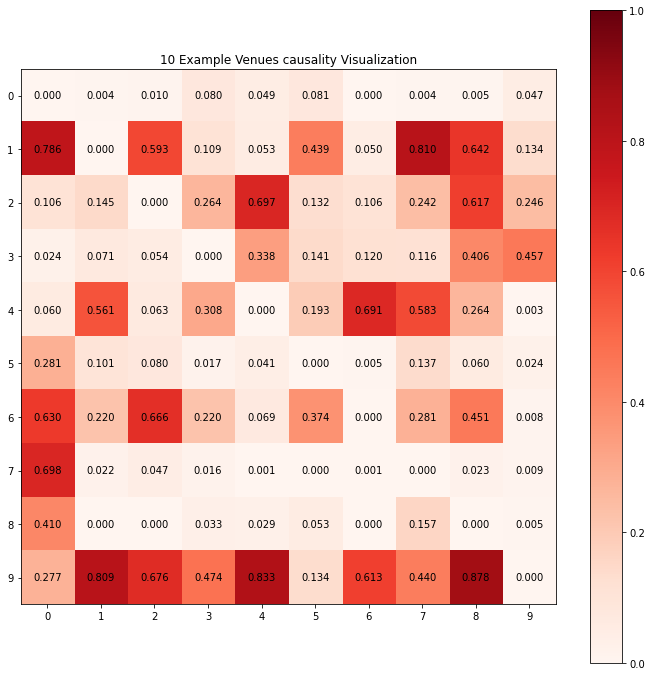

In [31]:
# 选择10个
sub_list = [row[:10] for row in pValues_sum_avg[:10]]

# 绘制热力图
# plt.imshow(sub_list, cmap='RdBu', vmin=0, vmax=1)

# 生成10x10的网格
X, Y = np.meshgrid(np.arange(0, 10, 1), np.arange(0, 10, 1))

# 给每个方格加上对应的元素值
for i in range(10):
    for j in range(10):
        plt.text(j, i, '{:.3f}'.format(sub_list[i][j]), ha='center', va='center')

# 调整图像大小
fig = plt.gcf()
fig.set_size_inches(12, 12)

# 显示热力图
plt.imshow(sub_list, cmap='Reds', vmin=0, vmax=1)

# 设置x轴和y轴标签
plt.xticks(np.arange(0, 10, 1))
plt.yticks(np.arange(0, 10, 1))

# 显示颜色条
plt.colorbar()

# 命名
plt.title('10 Example Venues causality Visualization')

plt.savefig('img/Causality Visualization_1')

# 显示图形
plt.show()


### 结果展示

In [32]:
print('高风险区',len(outliers_high))
print('中风险区',len(outliers_medium_temp))

高风险区 45
中风险区 73


In [33]:
print('总场所数',len(all_venues))
print('考虑到自身的相关性可能有因果关联的有',int((len(Strong_right)-len(all_venues))/2),'对。当关联元组中的一个场所发生疫情，则可考虑对另一个关联场所重点防控')

总场所数 2947
考虑到自身的相关性可能有因果关联的有 484 对。当关联元组中的一个场所发生疫情，则可考虑对另一个关联场所重点防控


高风险区展示

In [61]:
outliers_high = [x + 1 for x in outliers_high]

In [65]:
venue_highRisky = venue.loc[venue['grid_point_id'].isin(outliers_high[0])]
# 先将feature_3的index重命名为grid_point_id
feature_3.index.name = 'grid_point_id'
# 合并
venue_highRisky['累计阳性人次'] = venue_highRisky.apply(lambda row: feature_3.loc[row['grid_point_id'], '累计阳性人次'], axis=1)
# 先将feature_2的index重命名为grid_point_id
feature_2.index.name = 'grid_point_id'
# 合并
feature_2 = feature_2.rename(columns={feature_2.columns[0]: '流动人口'})
venue_highRisky['流动人口'] = venue_highRisky.apply(lambda row: feature_2.loc[row['grid_point_id'], '流动人口'],axis=1)
venue_highRisky

F:\Anaconda3 2022.10\lib\site-packages\ipykernel_launcher.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """
F:\Anaconda3 2022.10\lib\site-packages\ipykernel_launcher.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  # Remove the CWD from sys.path while we load stuff.


,grid_point_id,name,point_type,x_coordinate,y_coordinate,create_time,累计阳性人次,流动人口
101,102,地铁站2,交通,15179.91,12137.15,2022/7/5 16:27,17,101861
107,108,居民小区2,住宅,16331.03,11048.13,2021/1/23 21:56,15,141651
166,167,居民小区3,住宅,13308.25,15707.57,2020/7/10 2:35,17,141085
225,226,居民小区4,住宅,15713.85,12514.70,2020/4/27 8:36,11,148307
284,285,居民小区5,住宅,16441.30,13954.42,2020/7/11 14:27,12,145440
337,338,地铁站6,交通,11568.11,11986.94,2021/1/31 17:31,23,109774
454,455,公交车8,交通,14382.78,11931.00,2022/5/3 3:43,11,110036
461,462,居民小区8,住宅,16345.34,10696.84,2020/11/16 23:35,20,140738
514,515,地铁站9,交通,13938.52,9955.34,2021/6/25 6:16,19,90125
632,633,地铁站11,交通,13181.36,14217.89,2021/10/2 2:40,18,88652


中风险区展示

In [66]:
outliers_medium = [x + 1 for x in outliers_medium]

In [67]:
venue_mediumRisky = venue.loc[venue['grid_point_id'].isin(outliers_medium[0])]

venue_mediumRisky['累计阳性人次'] = venue_mediumRisky.apply(lambda row: feature_3.loc[row['grid_point_id'], '累计阳性人次'],axis=1)
venue_mediumRisky

# 先将feature_2的index重命名为grid_point_id
feature_2.index.name = 'grid_point_id'
feature_2 = feature_2.rename(columns={feature_2.columns[0]: '流动人口'})
venue_mediumRisky['流动人口'] = venue_mediumRisky.apply(lambda row: feature_2.loc[row['grid_point_id'], '流动人口'],axis=1)
venue_mediumRisky

F:\Anaconda3 2022.10\lib\site-packages\ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  This is separate from the ipykernel package so we can avoid doing imports until
F:\Anaconda3 2022.10\lib\site-packages\ipykernel_launcher.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  if __name__ == '__main__':


,grid_point_id,name,point_type,x_coordinate,y_coordinate,create_time,累计阳性人次,流动人口
48,49,居民小区1,住宅,14098.83,11960.41,2021/8/9 7:48,9,79936
101,102,地铁站2,交通,15179.91,12137.15,2022/7/5 16:27,17,101861
107,108,居民小区2,住宅,16331.03,11048.13,2021/1/23 21:56,15,141651
166,167,居民小区3,住宅,13308.25,15707.57,2020/7/10 2:35,17,141085
218,219,公交车4,交通,11808.33,14733.07,2021/12/24 3:26,11,65512
...,...,...,...,...,...,...,...,...
2815,2816,地铁站48,交通,9044.77,18237.79,2020/6/3 11:06,8,63119
2821,2822,居民小区48,住宅,11767.34,18431.86,2021/11/30 8:52,24,141053
2874,2875,地铁站49,交通,12332.49,17478.13,2021/10/23 20:07,16,63676
2880,2881,居民小区49,住宅,9290.16,17076.51,2022/5/1 2:34,20,140608


基本符合预期效果